## Genus Level Comparison 

In [1]:
suppressPackageStartupMessages({
    library(tidyverse)
    library(reshape2)
    library(ggpubr)
    library(matrixStats)
})

Warning message:
“package ‘tibble’ was built under R version 3.5.2”Warning message:
“package ‘purrr’ was built under R version 3.5.2”Warning message:
“package ‘dplyr’ was built under R version 3.5.2”Warning message:
“package ‘stringr’ was built under R version 3.5.2”Warning message:
“package ‘forcats’ was built under R version 3.5.2”

In [2]:
df = read.csv("all_samples_genus.csv")

In [3]:
df[1:5,1:5]

taxa,V1V2_HNO17_S8_R1,V1V2_HNO19_S9_R1,V1V2_HNO209_S14_R1,V1V2_HNO223_S15_R1
A2,0,0,0,0
ASF356,0,0,0,0
Abiotrophia,1,1,0,1
Acetitomaculum,0,0,0,0
Acholeplasma,0,0,0,0


In [4]:
df = df[ !grepl( 'POS|NEG', colnames(df))]

In [5]:
df2_mat = as.matrix( df[-1])
rownames(df2_mat) = df$taxa

In [6]:
df2_mat[1:5,1:5]

,V1V2_HNO17_S8_R1,V1V2_HNO19_S9_R1,V1V2_HNO209_S14_R1,V1V2_HNO223_S15_R1,V1V2_HNO23_S10_R1
A2,0,0,0,0,0
ASF356,0,0,0,0,0
Abiotrophia,1,1,0,1,1
Acetitomaculum,0,0,0,0,0
Acholeplasma,0,0,0,0,0


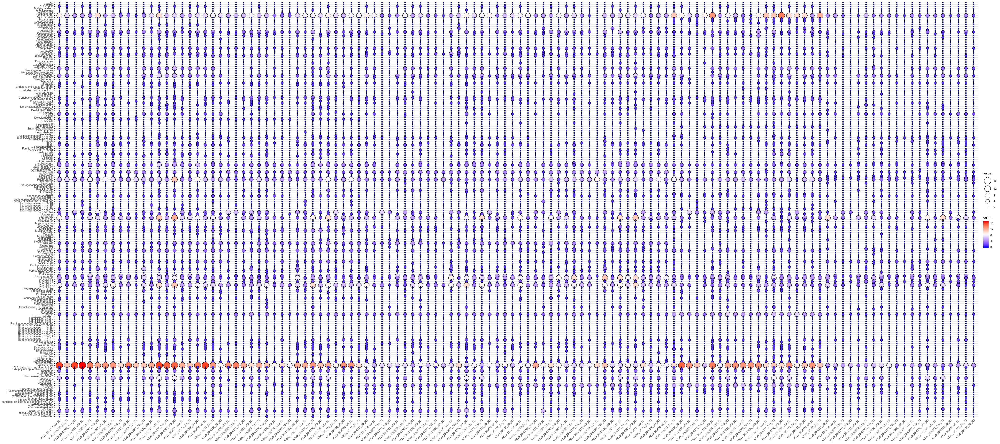

In [7]:
options( repr.plot.width=45, repr.plot.height=20)
ggballoonplot(df2_mat,fill = "value", shape=21) + gradient_fill(c("blue", "white", "red"))

In [8]:
# sets
primer_sets = unique( sapply(strsplit(colnames(df2_mat),'_'),'[[',1) )
primer_sets

[1] "V1V2" "V2V3" "V3V4" "V4V5" "V5V7" "V7V9"

In [9]:
#rowMeans(df2_mat[ , grep( primer_sets[1], colnames(df2_mat))])

In [10]:
new_df = list();
for( i in 1:length(primer_sets) ){
    primer= primer_sets[i]
    print(primer)
    new_df[[primer]] = rowMeans(df2_mat[ , grep( primer, colnames(df2_mat))])
    }

[1] "V1V2"
[1] "V2V3"
[1] "V3V4"
[1] "V4V5"
[1] "V5V7"
[1] "V7V9"


In [11]:
new_df = as.data.frame( new_df )

In [12]:
new_df2 = as.matrix( new_df)
rownames(new_df2) = rownames(new_df)

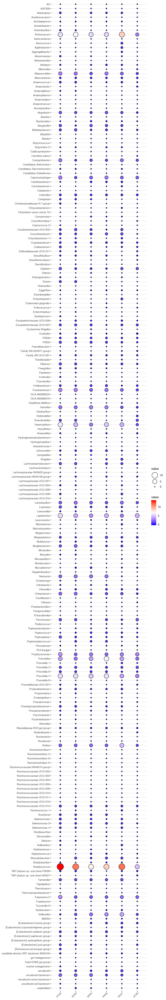

In [13]:
options( repr.plot.width=8, repr.plot.height=48)
ggballoonplot(new_df2,fill = "value", shape=21) + gradient_fill(c("blue", "white", "red"))

In [14]:
dx = as.data.frame( t( df2_mat ) )

In [15]:
dim(dx)

[1] 120 228

In [16]:
dx$group = sapply(strsplit(rownames(dx),'_'),'[',1)

In [17]:
dx %>% head

,A2,ASF356,Abiotrophia,Acetitomaculum,Acholeplasma,Acinetobacter,Actinobacillus,Actinomyces,Aeriscardovia,Aerococcus,⋯,candidate division SR1 bacterium MGEHA,gut metagenome,hoa5-07d05 gut group,marine metagenome,uncultured,uncultured bacterium,uncultured rumen bacterium,uncultured soil bacterium,unidentified,group
V1V2_HNO17_S8_R1,0,0,1,0,0,0,0,9,0,0,⋯,0,0,0,0,0,3,0,0,0,V1V2
V1V2_HNO19_S9_R1,0,0,1,0,0,0,0,7,0,0,⋯,0,0,0,0,0,4,0,0,0,V1V2
V1V2_HNO209_S14_R1,0,0,0,0,0,0,0,5,0,0,⋯,0,0,0,0,0,1,0,0,0,V1V2
V1V2_HNO223_S15_R1,0,0,1,0,0,0,0,5,0,0,⋯,0,0,0,0,2,3,0,0,0,V1V2
V1V2_HNO23_S10_R1,0,0,1,0,0,0,1,4,0,0,⋯,1,0,0,0,1,1,0,0,0,V1V2
V1V2_HNO262_S16_R1,0,0,0,0,0,0,0,10,0,0,⋯,0,0,0,1,0,1,0,0,0,V1V2


In [18]:
dx$taxa = rownames(dx)

In [19]:
rownames(dx) = NULL

In [20]:
dxmelt=melt(dx)

Using group, taxa as id variables


In [21]:
head(dxmelt)

group,taxa,variable,value
V1V2,V1V2_HNO17_S8_R1,A2,0
V1V2,V1V2_HNO19_S9_R1,A2,0
V1V2,V1V2_HNO209_S14_R1,A2,0
V1V2,V1V2_HNO223_S15_R1,A2,0
V1V2,V1V2_HNO23_S10_R1,A2,0
V1V2,V1V2_HNO262_S16_R1,A2,0


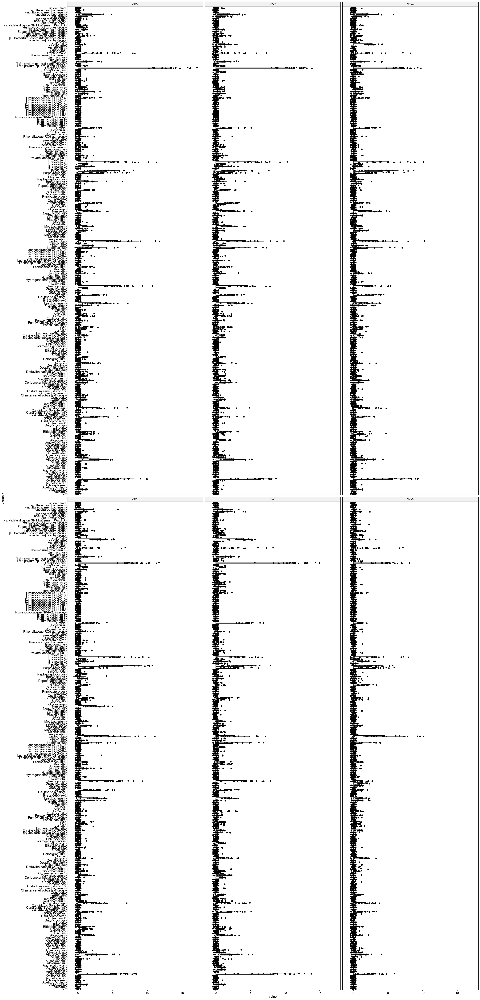

In [22]:
options( repr.plot.width=25, repr.plot.height=52)
ggbarplot(dxmelt, x = "variable", y = "value", facet.by = "group",
          add = c("mean_sd","jitter"), 
          error.plot = c("pointrange"), 
          position = position_dodge(), 
          label = FALSE, 
          orientation = "horiz",
          #color = "taxa",
          #palette = c("","","")
         )

Warning message:
“Removed 27360 rows containing missing values (geom_pointrange).”

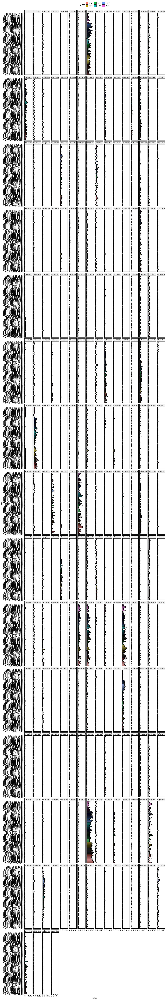

In [23]:
suppressWarnings({
options( repr.plot.width=15, repr.plot.height=90)
ggbarplot(dxmelt, x = "taxa", y = "value", facet.by = "variable",fill="group",
          add = c("mean_sd","jitter"), 
          error.plot = c("pointrange"), 
          position = position_dodge(), 
          label = FALSE, 
          orientation = "horiz",
         )})

Warning message:
“Removed 761 rows containing missing values (geom_pointrange).”

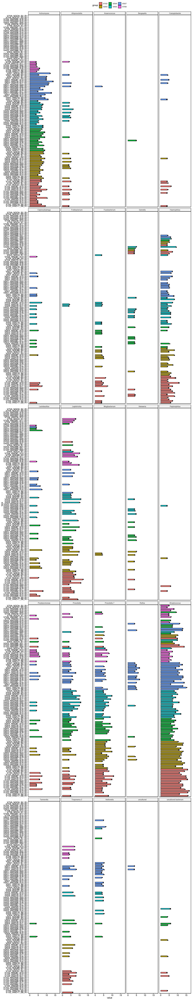

In [24]:
suppressWarnings({
options( repr.plot.width=15, repr.plot.height=78)
dxmelt[dxmelt$value > 3,] %>% ## filter
ggbarplot( x = "taxa", y = "value", facet.by = "variable",fill="group",
          add = c("mean_sd","jitter"), 
          error.plot = c("pointrange"), 
          position = position_dodge(), 
          label = FALSE, 
          orientation = "horiz",
         )})

Warning message:
“Removed 12 rows containing missing values (geom_pointrange).”

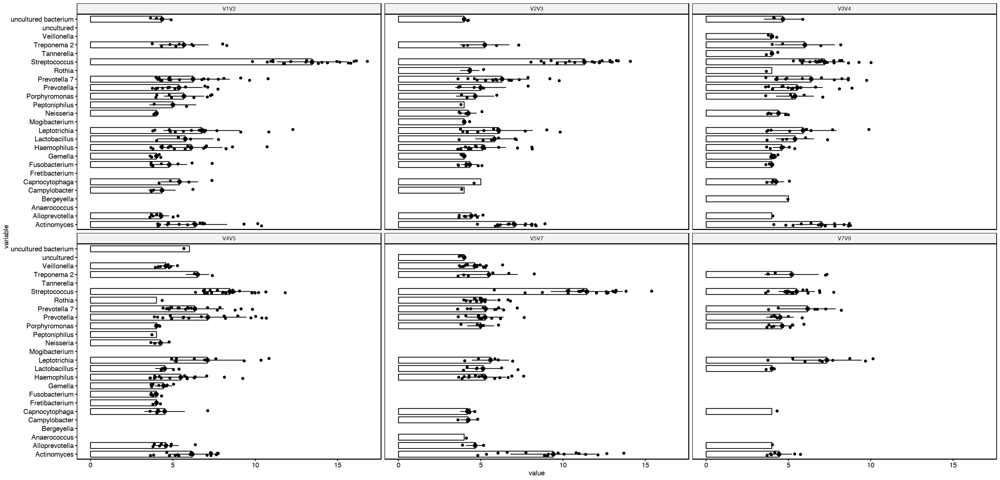

In [25]:
suppressWarnings({
options( repr.plot.width=25, repr.plot.height=12)
dxmelt[dxmelt$value > 3,] %>% 
ggbarplot(x = "variable", y = "value", facet.by = "group",
          add = c("mean_sd","jitter"), 
          error.plot = c("pointrange"), 
          position = position_dodge(), 
          label = FALSE, 
          orientation = "horiz",
          #color = "taxa",
         )})